In [1]:
class Number:
    def __init__(self, x, y, index, val):
        self.x = x
        self.y = y
        self.index = index
        self.val = val

    def get_x(self):
        return self.x

    def get_y(self):
        return self.y

    def get_index(self):
        return self.index

    def get_val(self):
        return self.val

    def distance(self, point):
        # Euclidean distance beetween this point and other
        import math
        return math.sqrt(abs(self.get_x() - point.get_x()) + 
                         abs(self.get_y() - point.get_y()))

In [73]:
import math
import os
import sys
import numpy as np
from PIL import Image
from sklearn.manifold import TSNE
from sklearn.cluster import Birch, KMeans

class AnomalousMovingMNIST:
    '''
    Args:
    anom_frames: list of anomalous frame indexes that must appear in the sequence
    num_anoms_per_frame: how many MNIST numbers have to be anomalous in an anomalous frame
    n_clusters: number of clusters to perform K-Means. 
        More clusters imply smaller cluster size, more similarity between instances but less variety.
        Less clusters imply bigger cluster size, less similarity between instances but more variety.
    dataset = {training, test}: specifies whether the dataset should be created from the MNIST training set or test set
    '''
    def __init__(self, 
                 anom_frames,
                 num_anoms_per_frame,
                 type_of_anomaly,
                 num_sequences=20000,
                 shape=(64, 64),
                 num_frames=30,
                 original_size=28,
                 nums_per_image=2,
                 path_data = '',
                 path_labels = '',
                 path_tSNE = '',
                 n_clusters = 9,
                 dest='anomovingmnistdata',
                 filetype='npz',
                 dataset='test',):
        if(not num_anoms_per_frame in [1,2]):
            raise ValueError("num_anoms_per_frame must be 1 or 2")
        
        if(not dataset in ['training', 'test']):
            raise ValueError("possible values: {training, test}")
        
        self.shape = shape
        self.num_frames = num_frames
        self.num_sequences = num_sequences
        self.original_size = original_size
        self.nums_per_image = nums_per_image
        self.dest = dest
        self.filetype = filetype
        self.dataset = dataset
        self.path_data = path_data
        self.path_labels = path_labels
        self.path_tSNE = path_tSNE
        self.n_clusters = n_clusters
        self.anom_frames = anom_frames
        self.num_anoms_per_frame = num_anoms_per_frame
        self.type_of_anomaly = type_of_anomaly
    
    def arr_from_img(self, im, mean=0, std=1):
        '''

        Args:
            im: Image
            shift: Mean to subtract
            std: Standard Deviation to subtract

        Returns:
            Image in np.float32 format, in width height channel format. With values in range 0,1
            Shift means subtract by certain value. Could be used for mean subtraction.
        '''
        width, height = im.size
        arr = im.getdata()
        c = int(np.product(arr.size) / (width * height))

        return (np.asarray(arr, dtype=np.float32).reshape((height, width, c)).transpose(2, 1, 0)) / std

    def get_image_from_array(self, X, index, mean=0, std=1):
        '''

        Args:
            X: Dataset of shape N x C x W x H
            index: Index of image we want to fetch
            mean: Mean to add
            std: Standard Deviation to add
        Returns:
            Image with dimensions H x W x C or H x W if it's a single channel image
        '''
        ch, w, h = X.shape[1], X.shape[2], X.shape[3]
        ret = (((X[index] + mean)) * std).reshape(ch, w, h).transpose(2, 1, 0)#.clip(0, 255).astype(np.uint8)
        if ch == 1:
            ret = ret.reshape(h, w)
        return ret

    #Load dataset from sklearn
    def load_dataset_from_sklearn(self):
        data = []
        labels = []
        data_reshaped = []
        try:
            data = np.load(self.path_data, allow_pickle=True)
            labels = np.load(self.path_labels, allow_pickle=True)
            print('Loaded dataset from file system')
        except:
            from sklearn.datasets import fetch_openml
            print("Downloading MNIST "+self.dataset+" set from sklearn")
            data, labels = fetch_openml('mnist_784', version=1, return_X_y=True)
            data = np.asarray(data)
            labels = np.asarray(labels)
            data_reshaped = data.reshape(-1, 1, 28, 28).transpose(0, 1, 3, 2)
            np.save('data', data)
            np.save('labels', labels)
            print(("done"))
        if (self.dataset == 'training'):
            return data[:60000], data_reshaped[:60000] / np.float32(255), labels[:60000]
        return data[-10000:], data_reshaped[-10000:] / np.float32(255), labels[-10000:]

    def perform_tSNE(self, data):
        img_embed = None
        try:
            img_embed = np.load(self.path_tSNE)
            print("Loading existing t-SNE embedding from file system")
            print("done")
        except:
            print("Performing t-SNE on a dataset of shape "+str(data.shape)+"...")
            tsne = TSNE(n_components=2)
            img_embed = tsne.fit_transform(data)
            np.save(self.path_tSNE, img_embed)
        return img_embed
    
    def perform_Birch(self, embedding, labels, n_clusters):
        print("Performing Birch. K =",n_clusters)
        clusters_dimension = [0]*n_clusters
        birch = KMeans(n_clusters=n_clusters, random_state=0).fit(embedding)
        distances = KMeans(n_clusters=n_clusters, random_state=0).fit_transform(embedding)
        for i in birch.labels_:
                clusters_dimension[i]+=1
        clusters = [ [] for i in range(n_clusters)]
        pos = 0
        for i in birch.labels_:
                clusters[i].append(Number(embedding[pos, 0], embedding[pos, 1], pos, labels[pos]))
                pos+=1

        med = np.argmin(distances, axis=0)
        clusters_others = {}
        for i in range(len(clusters)):
            cluster = clusters[i]
            medoid = med[i]
            others = [x.get_index() for x in cluster if x.get_val()!=str(labels[medoid])]
            clusters_others[medoid]=others

        return clusters, clusters_others, birch.labels_

        

    def generate_moving_mnist(self, 
                              dataset='test', 
                              shape=(64, 64), 
                              num_frames=20, 
                              num_sequences=10000, 
                              original_size=28,
                              nums_per_image=2):
        '''

        Args:
        dataset = {test, training}: used to decide if downloading/generating train set or test set
        shape: Shape we want for our moving images (new_width and new_height)
        num_frames: Number of frames in a particular movement/animation/gif
        num_sequences: Number of movement/animations/gif to generate
        original_size: Real size of the images (eg: MNIST is 28x28)
        nums_per_image: Digits per movement/animation/gif.

        Returns:
        Dataset of np.uint8 type with dimensions num_frames * num_sequences x 1 x new_width x new_height

        '''
        if(self.dataset == 'training'):
            print("Generating training set of shape ("+str(self.num_sequences)+", "+
                  str(self.num_frames)+", 1, "+str(self.shape[0])+", "+str(self.shape[1])+")")
        else:
            print("Generating test set of shape ("+str(self.num_sequences)+", "+
                  str(self.num_frames)+", 1, "+str(self.shape[0])+", "+str(self.shape[1])+")")
            
        data, mnist, labels = self.load_dataset_from_sklearn()
        
        img_embed = self.perform_tSNE(data)
        _, med_other, predicted_labels = self.perform_Birch(img_embed, labels, n_clusters=self.n_clusters)
        np.save("predicted_labels", predicted_labels)
        
        '''
        index_list = medoids
        index_list_false = candidates
        mnist_false = data[index_list_false].reshape(-1, 1, 28, 28)#.transpose(0, 1, 3, 2)
        '''
        mnist = data.reshape(-1, 1, 28, 28)#.transpose(0, 1, 3, 2)
        
        print("Building dataset...")
        width, height = self.shape
        # Get how many pixels can we move around a single image
        lims = (x_lim, y_lim) = width - original_size, height - original_size

        # Create a dataset of shape of num_frames * num_sequences x 1 x new_width x new_height
        # Eg : 3000000 x 1 x 64 x 64
        dataset = np.empty((self.num_frames * self.num_sequences, 1, width, height), dtype=np.uint8)

        for img_idx in range(self.num_sequences):
            direcs = np.pi * (np.random.rand(self.nums_per_image) * 2 - 1)
            speeds = np.random.randint(5, size=self.nums_per_image) + 2
            veloc = np.asarray(
                [(speed * math.cos(direc), speed * math.sin(direc)) for direc, speed in zip(direcs, speeds)])
            
            # Get a list containing two PIL images randomly sampled from the database
            #casual_index = np.random.randint(0, mnist.shape[0], nums_per_image)
            casual_index = np.random.randint(0, self.n_clusters, self.nums_per_image)
            mnist_images = []
            image_false = None
            mnist_images_false = None
            medoids = list(med_other.keys())

            for r in casual_index:
                mnist_images.append(Image.fromarray(self.get_image_from_array(mnist, medoids[r], mean=0)).resize((original_size, original_size), Image.ANTIALIAS))
            
            anom_list_med_1 = med_other[medoids[casual_index[0]]]
            anom_list_med_2 = med_other[medoids[casual_index[1]]]
            np.random.shuffle(anom_list_med_1)
            np.random.shuffle(anom_list_med_2)
            
            anom_index_1 = medoids[casual_index[0]]
            while labels[anom_index_1] == labels[medoids[casual_index[0]]]:
                anom_index_1 = np.random.choice(anom_list_med_1)
    
#             print("Original")
#             print(labels[medoids[casual_index[0]]])
#             plt.imshow(Image.fromarray(self.get_image_from_array(mnist, medoids[casual_index[0]], mean=0)).resize((original_size, original_size), Image.ANTIALIAS))
#             plt.show()
#             print("Fake")
#             print(labels[anom_index_1])
#             plt.imshow(Image.fromarray(self.get_image_from_array(mnist, anom_index_1, mean=0)).resize((original_size, original_size), Image.ANTIALIAS))
#             plt.show()
#             print("Done")
            
            anom_index_2 = medoids[casual_index[1]]
            while labels[anom_index_2] == labels[medoids[casual_index[1]]]:
                anom_index_2 = np.random.choice(anom_list_med_2)
                
#             print("Original")
#             print(labels[medoids[casual_index[1]]])
#             plt.imshow(Image.fromarray(self.get_image_from_array(mnist, medoids[casual_index[1]], mean=0)).resize((original_size, original_size), Image.ANTIALIAS))
#             plt.show()
#             print("Fake")
#             print(labels[anom_index_2])
#             plt.imshow(Image.fromarray(self.get_image_from_array(mnist, anom_index_2, mean=0)).resize((original_size, original_size), Image.ANTIALIAS))
#             plt.show()
#             print("Done")
            
            
            image_false1 = Image.fromarray(self.get_image_from_array(mnist, anom_index_1, mean=0)).resize((original_size, original_size), Image.ANTIALIAS)
            image_false2 = Image.fromarray(self.get_image_from_array(mnist, anom_index_2, mean=0)).resize((original_size, original_size), Image.ANTIALIAS)
            
            if(self.num_anoms_per_frame == 1):
                rand_idx = np.random.randint(2)
                mnist_images_false = [image_false1, image_false2]
                mnist_images_false[rand_idx] = mnist_images[rand_idx]

            if(self.num_anoms_per_frame == 2):
                mnist_images_false = [image_false1, image_false2]

            # Generate tuples of (x,y) i.e initial positions for nums_per_image (default : 2)
            positions = np.asarray(
                [(np.random.rand() * x_lim, np.random.rand() * y_lim) for _ in range(self.nums_per_image)])
            positions_false = np.asarray(
                [(np.random.rand() * x_lim, np.random.rand() * y_lim) for _ in range(self.nums_per_image)])

            # Generate new frames for the entire num_framesgth
            for frame_idx in range(self.num_frames):
                canvases = [Image.new('L', (width, height)) for _ in range(self.nums_per_image)]
                canvas = np.zeros((1, width, height), dtype=np.float32)

                # In canv (i.e Image object) place the image at the respective positions
                # Super impose both images on the canvas (i.e empty np array)
                for i, canv in enumerate(canvases):
                    im = mnist_images[i]
                    if(frame_idx in self.anom_frames):
                        im = mnist_images_false[i]    
                        #canv.paste(im, tuple(positions_false[i].astype(int)))
                    #else:    
                    canv.paste(im, tuple(positions[i].astype(int)))
                    canvas += self.arr_from_img(canv, mean=0)

                # Get the next position by adding velocity
                next_pos = positions + veloc

                # Iterate over velocity and see if we hit the wall
                # If we do then change the  (change direction)
                for i, pos in enumerate(next_pos):
                    for j, coord in enumerate(pos):
                        if coord < -2 or coord > lims[j] + 2:
                            veloc[i] = list(list(veloc[i][:j]) + [-1 * veloc[i][j]] + list(veloc[i][j + 1:]))

                # Make the permanent change to position by adding updated velocity
                positions = positions + veloc

                # Add the canvas to the dataset array
                dataset[img_idx * num_frames + frame_idx] = ((canvas).clip(0, 255)).astype(np.float32)
        #Reshape dataset to have a shape like (30, 100, 1, 64, 64)
        dataset = dataset.reshape(self.num_sequences, self.num_frames, 1, width, height)
        print("done! :)")
        return dataset

    def generate_ano_mnist(self):
        data = self.generate_moving_mnist()

        n = self.num_sequences * self.num_frames
        if self.filetype == 'npz':
            np.savez(self.dest, anommnist=data)
        elif filetype == 'jpg':
            for i in range(data.shape[0]):
                Image.fromarray(self.get_image_from_array(data, i, mean=0)).save(os.path.join(dest, '{}.jpg'.format(i)))


        

In [77]:
from sklearn.metrics import silhouette_samples, silhouette_score
import matplotlib.cm as cm

def compute_and_print_silhouette_for_birch(threshold=0.5, branching_factor=50):
    img_embed = np.load("sne.npy")

    range_n_clusters = range(2, 30)

    for n_clusters in range_n_clusters:
        # Create a subplot with 1 row and 2 columns
        fig, (ax1, ax2) = plt.subplots(1, 2)
        fig.set_size_inches(18, 7)

        # The 1st subplot is the silhouette plot
        # The silhouette coefficient can range from -1, 1 but in this example all
        # lie within [-0.1, 1]
        ax1.set_xlim([-0.1, 1])
        # The (n_clusters+1)*10 is for inserting blank space between silhouette
        # plots of individual clusters, to demarcate them clearly.
        ax1.set_ylim([0, len(img_embed) + (n_clusters + 1) * 10])

        # Initialize the clusterer with n_clusters value and a random generator
        # seed of 10 for reproducibility.
        clusterer = Birch(n_clusters=n_clusters, threshold=threshold,
                         branching_factor=branching_factor)
        cluster_labels = clusterer.fit_predict(img_embed)

        # The silhouette_score gives the average value for all the samples.
        # This gives a perspective into the density and separation of the formed
        # clusters
        silhouette_avg = silhouette_score(img_embed, cluster_labels)
        print("For n_clusters =", n_clusters,
              "The average silhouette_score is :", silhouette_avg)

        # Compute the silhouette scores for each sample
        sample_silhouette_values = silhouette_samples(img_embed, cluster_labels)

        y_lower = 10
        for i in range(n_clusters):
            # Aggregate the silhouette scores for samples belonging to
            # cluster i, and sort them
            ith_cluster_silhouette_values = \
                sample_silhouette_values[cluster_labels == i]

            ith_cluster_silhouette_values.sort()

            size_cluster_i = ith_cluster_silhouette_values.shape[0]
            y_upper = y_lower + size_cluster_i

            color = cm.nipy_spectral(float(i) / n_clusters)
            ax1.fill_betweenx(np.arange(y_lower, y_upper),
                              0, ith_cluster_silhouette_values,
                              facecolor=color, edgecolor=color, alpha=0.7)

            # Label the silhouette plots with their cluster numbers at the middle
            ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

            # Compute the new y_lower for next plot
            y_lower = y_upper + 10  # 10 for the 0 samples

        ax1.set_title("The silhouette plot for the various clusters.")
        ax1.set_xlabel("The silhouette coefficient values")
        ax1.set_ylabel("Cluster label")

        # The vertical line for average silhouette score of all the values
        ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

        ax1.set_yticks([])  # Clear the yaxis labels / ticks
        ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

        # 2nd Plot showing the actual clusters formed
        colors = cm.nipy_spectral(cluster_labels.astype(float) / n_clusters)
        ax2.scatter(img_embed[:, 0], img_embed[:, 1], marker='.', s=30, lw=0, alpha=0.7,
                    c=colors, edgecolor='k')

    #     # Labeling the clusters
    #     centers = clusterer.cluster_centers_
    #     # Draw white circles at cluster centers
    #     ax2.scatter(centers[:, 0], centers[:, 1], marker='o',
    #                 c="white", alpha=1, s=200, edgecolor='k')

    #     for i, c in enumerate(centers):
    #         ax2.scatter(c[0], c[1], marker='$%d$' % i, alpha=1,
    #                     s=50, edgecolor='k')

        ax2.set_title("The visualization of the clustered data.")
        ax2.set_xlabel("Feature space for the 1st feature")
        ax2.set_ylabel("Feature space for the 2nd feature")

        plt.suptitle(("Silhouette analysis for KMeans clustering on sample data "
                      "with n_clusters = %d" % n_clusters),
                     fontsize=14, fontweight='bold')

    plt.show()
    return None

In [74]:
gen = AnomalousMovingMNIST(
    anom_frames=[5],
    num_anoms_per_frame=1,
    type_of_anomaly = None,
    num_frames=20, 
    num_sequences=200,
    n_clusters=30,
    dataset = 'test',
    path_data='data.npy', 
    path_labels='labels.npy', 
    path_tSNE='sne.npy', 
    dest='anommnist')

gen.generate_ano_mnist()

dat = np.load('anommnist.npz')['anommnist']

Generating test set of shape (200, 20, 1, 64, 64)
done
Performing t-SNE on a dataset of shape (10000, 784)...
Performing Birch. K = 30
Building dataset...
done! :)


In [78]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation

def create_gifs(number_of_gifs=20):
    for j in range(0, number_of_gifs):
        fig = plt.figure()

        ims = []
        for i in range(0,20):
            im = plt.imshow(dat[j,i,0,])
            ims.append([im])

        ani = animation.ArtistAnimation(fig, ims, interval=300, blit=True,
                                        repeat_delay=10000)

        ani.save('dynamic_images' + str(j) + '.gif')
    return None

In [ ]:
create_gifs()

In [79]:
from mpl_toolkits.mplot3d import Axes3D
import matplotlib as mpl

def plot_3d_sne():
#     DOAR DACA SNE E IN 3 DIMENSIUNI
    tsne_embedding = np.load("sne.npy")
    predicted_labels = np.load("predicted_labels.npy", allow_pickle=True)

    xs = list(map(lambda x: x[0], tsne_embedding))
    ys = list(map(lambda x: x[1], tsne_embedding))
    zs = list(map(lambda x: x[2], tsne_embedding))

    fig = plt.figure(num=None, figsize=(18, 12), dpi=80, facecolor='w', edgecolor='k')

    N = 30

    cmap = plt.cm.jet
    # extract all colors from the .jet map
    cmaplist = [cmap(i) for i in range(cmap.N)]
    # create the new map
    cmap = cmap.from_list('Custom cmap', cmaplist, cmap.N)

    ax = fig.add_subplot(111, projection='3d')

    ax.scatter(xs, ys, zs, c=predicted_labels, cmap=cmap)

    plt.show()
    return None

For n_clusters = 2 The average silhouette_score is : 0.32232618
For n_clusters = 3 The average silhouette_score is : 0.3415589
For n_clusters = 4 The average silhouette_score is : 0.34629595
For n_clusters = 5 The average silhouette_score is : 0.36990112
For n_clusters = 6 The average silhouette_score is : 0.3880395
For n_clusters = 7 The average silhouette_score is : 0.4194335
For n_clusters = 8 The average silhouette_score is : 0.4255898
For n_clusters = 9 The average silhouette_score is : 0.42144775
For n_clusters = 10 The average silhouette_score is : 0.42436695
For n_clusters = 11 The average silhouette_score is : 0.44530722
For n_clusters = 12 The average silhouette_score is : 0.42846268
For n_clusters = 13 The average silhouette_score is : 0.41951376
For n_clusters = 14 The average silhouette_score is : 0.42151254
For n_clusters = 15 The average silhouette_score is : 0.4191467
For n_clusters = 16 The average silhouette_score is : 0.41626358
For n_clusters = 17 The average silhou

<ipython-input-77-8784fd9bf5c6>:11: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, (ax1, ax2) = plt.subplots(1, 2)


For n_clusters = 22 The average silhouette_score is : 0.36093837
For n_clusters = 23 The average silhouette_score is : 0.36478835
For n_clusters = 24 The average silhouette_score is : 0.36092064
For n_clusters = 25 The average silhouette_score is : 0.36669946
For n_clusters = 26 The average silhouette_score is : 0.362239
For n_clusters = 27 The average silhouette_score is : 0.35398087
For n_clusters = 28 The average silhouette_score is : 0.34828588
For n_clusters = 29 The average silhouette_score is : 0.34803873


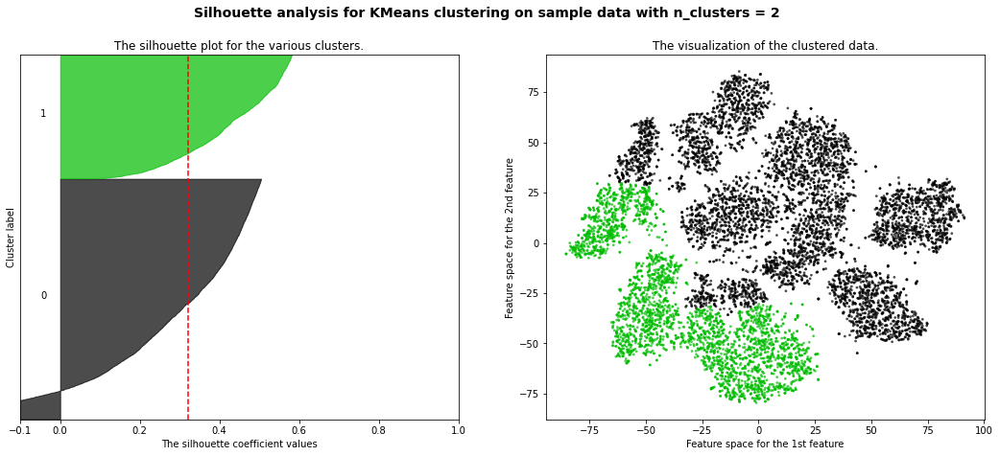

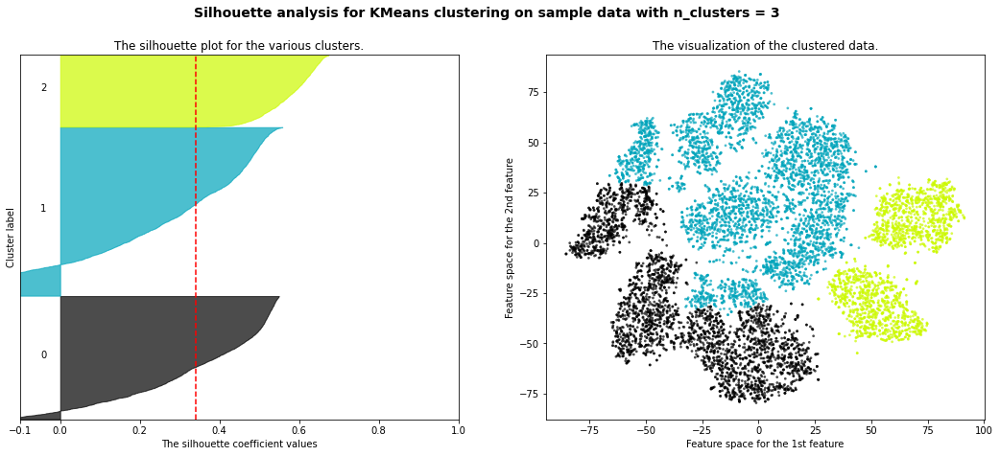

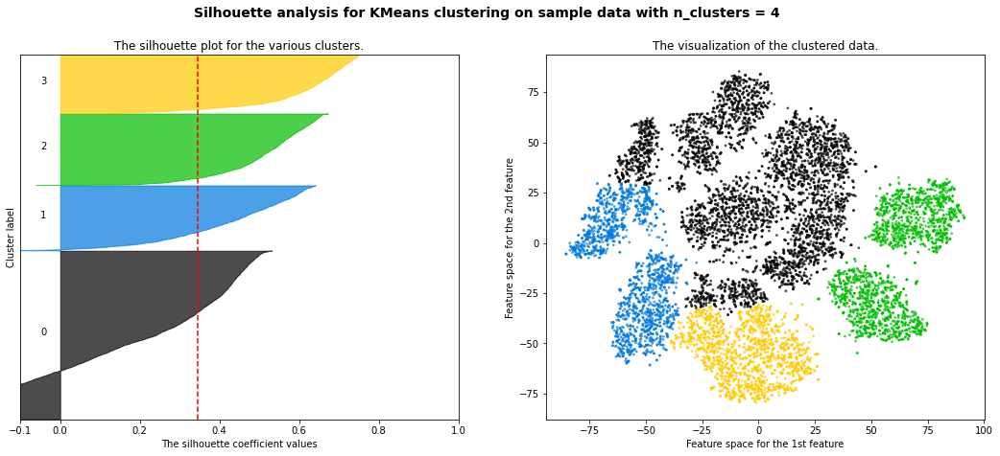

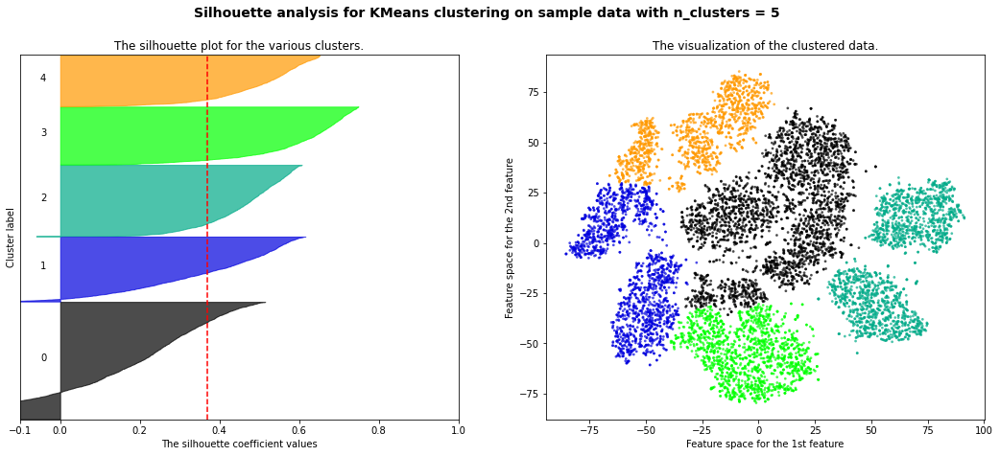

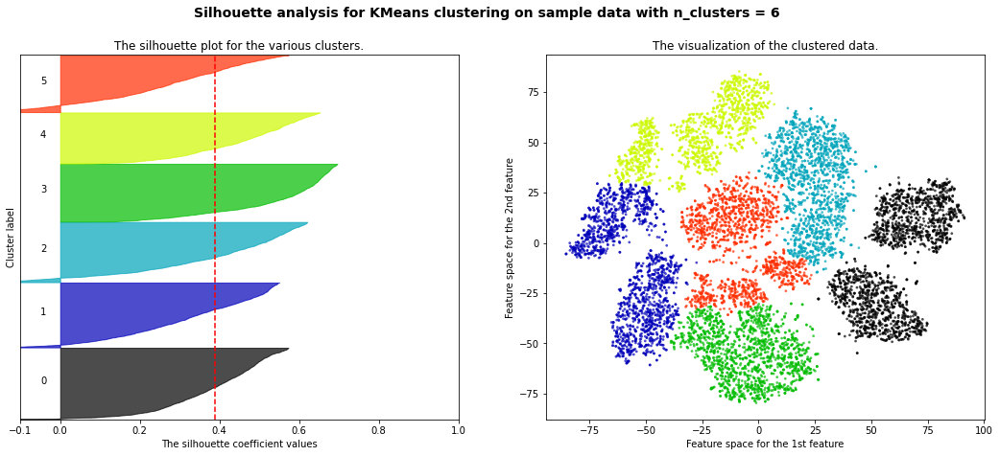

...

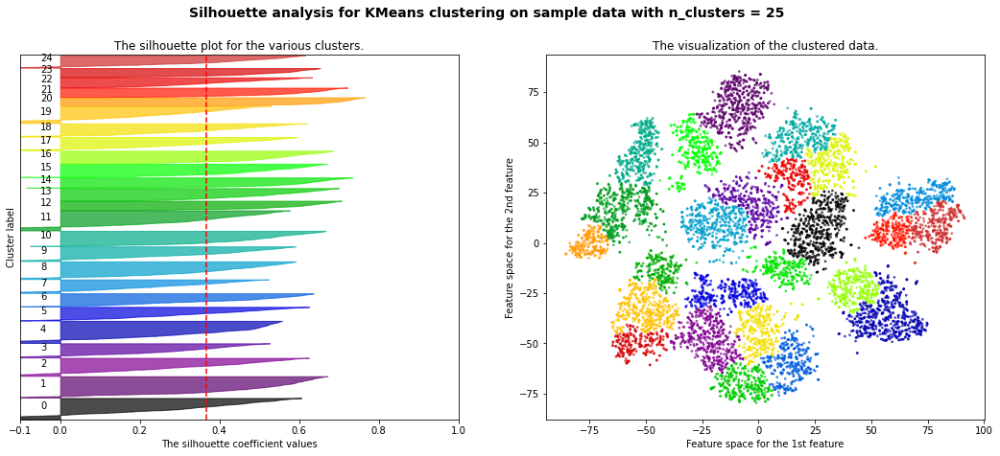

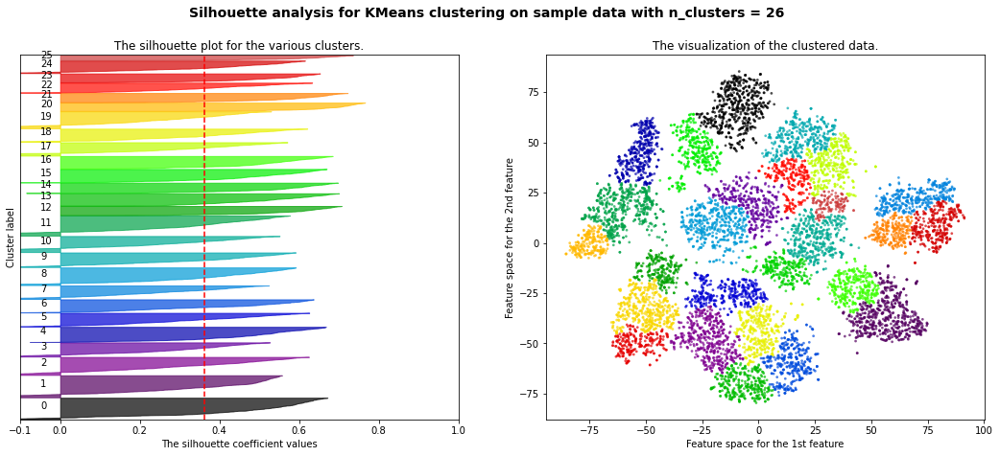

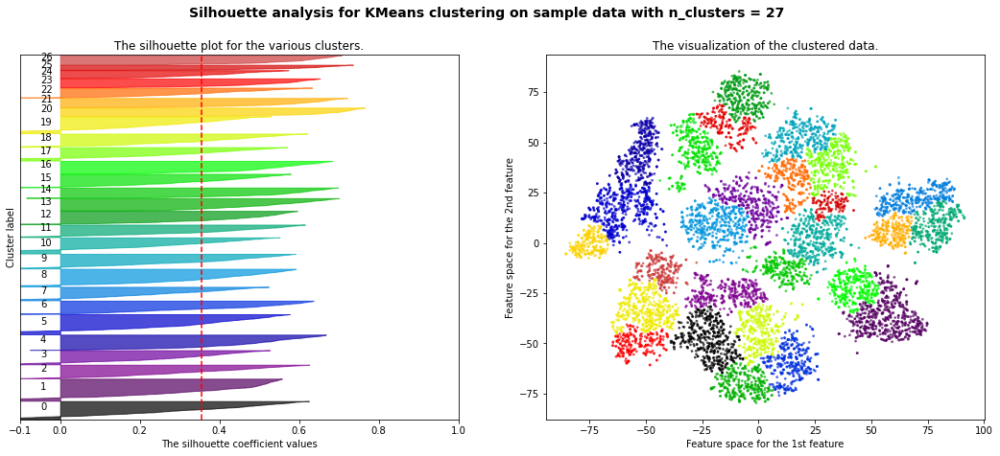

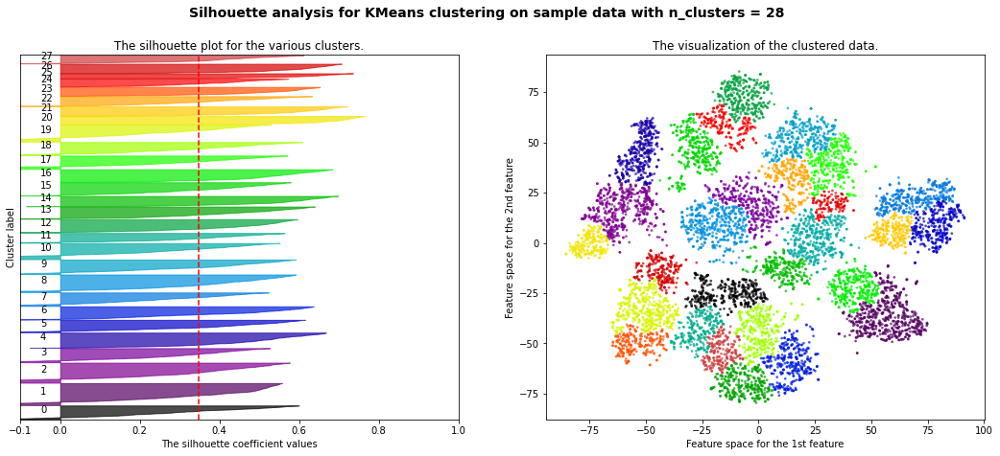

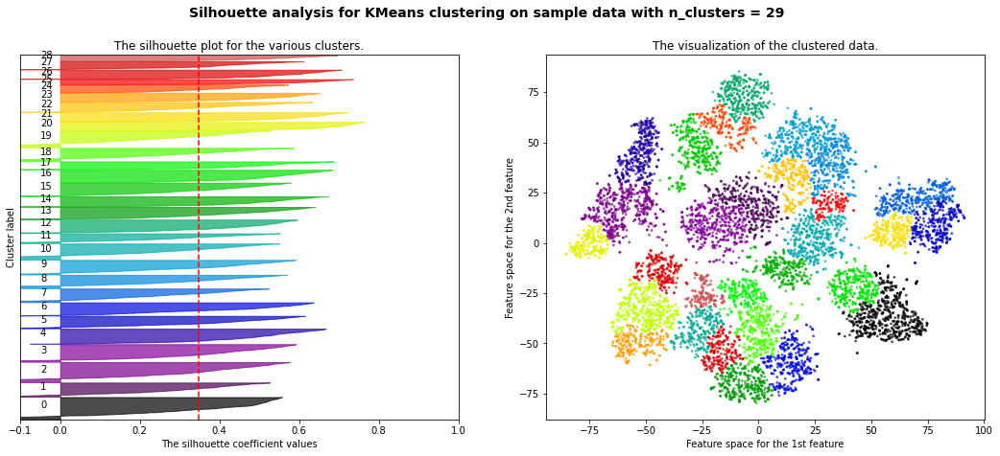

In [80]:
compute_and_print_silhouette_for_birch(threshold=0.5, branching_factor=50)

For n_clusters = 2 The average silhouette_score is : 0.3074769
For n_clusters = 3 The average silhouette_score is : 0.38429502
For n_clusters = 4 The average silhouette_score is : 0.3961921
For n_clusters = 5 The average silhouette_score is : 0.39320806
For n_clusters = 6 The average silhouette_score is : 0.39838806
For n_clusters = 7 The average silhouette_score is : 0.41653803
For n_clusters = 8 The average silhouette_score is : 0.43939677
For n_clusters = 9 The average silhouette_score is : 0.45163912
For n_clusters = 10 The average silhouette_score is : 0.44559443
For n_clusters = 11 The average silhouette_score is : 0.44390562
For n_clusters = 12 The average silhouette_score is : 0.43320116
For n_clusters = 13 The average silhouette_score is : 0.42619154
For n_clusters = 14 The average silhouette_score is : 0.41989854
For n_clusters = 15 The average silhouette_score is : 0.40100586
For n_clusters = 16 The average silhouette_score is : 0.39799348
For n_clusters = 17 The average sil

<ipython-input-77-8784fd9bf5c6>:11: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, (ax1, ax2) = plt.subplots(1, 2)


For n_clusters = 22 The average silhouette_score is : 0.3575084
For n_clusters = 23 The average silhouette_score is : 0.35776913
For n_clusters = 24 The average silhouette_score is : 0.3616125
For n_clusters = 25 The average silhouette_score is : 0.36121577
For n_clusters = 26 The average silhouette_score is : 0.35818756
For n_clusters = 27 The average silhouette_score is : 0.35562897
For n_clusters = 28 The average silhouette_score is : 0.35583034
For n_clusters = 29 The average silhouette_score is : 0.35406125


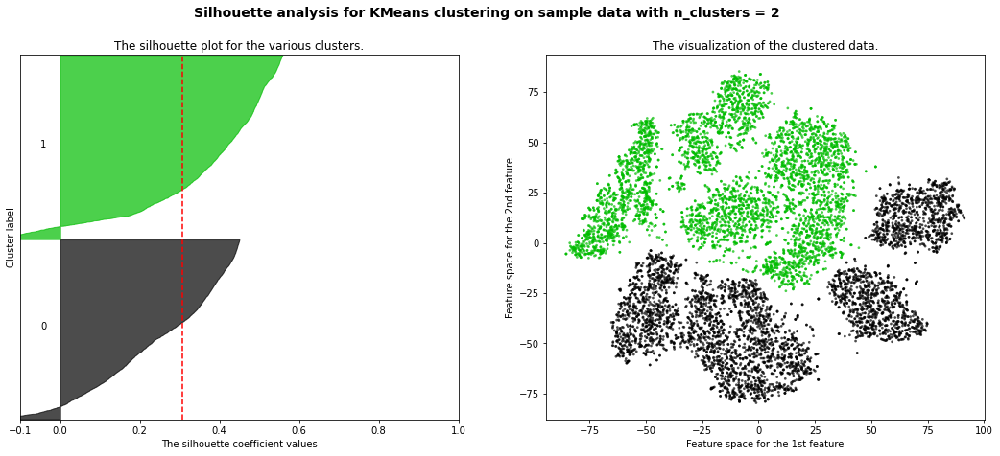

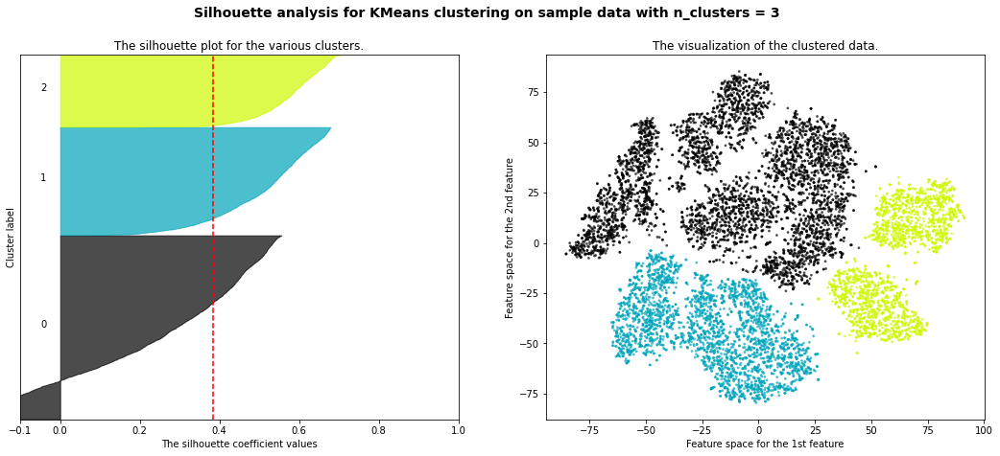

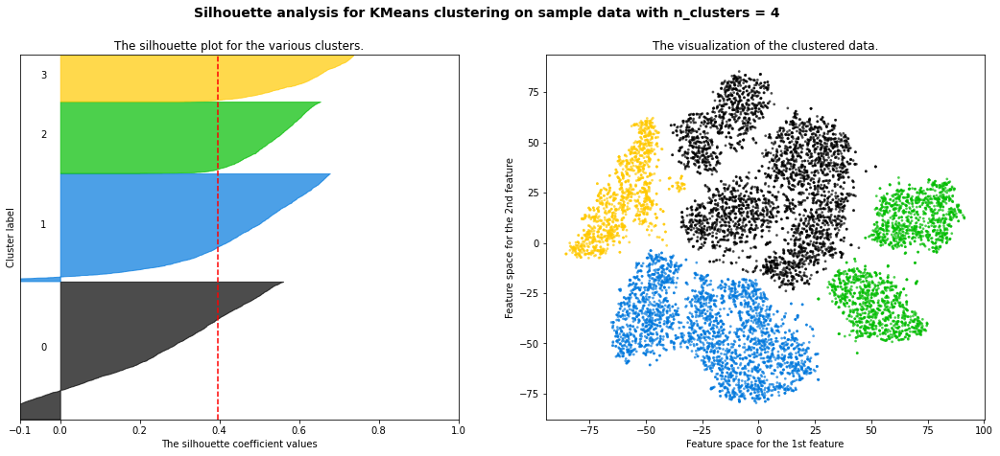

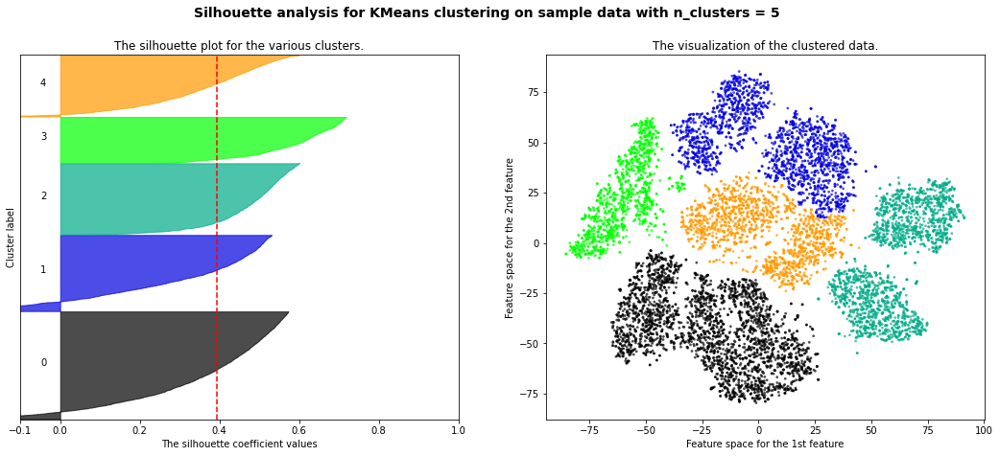

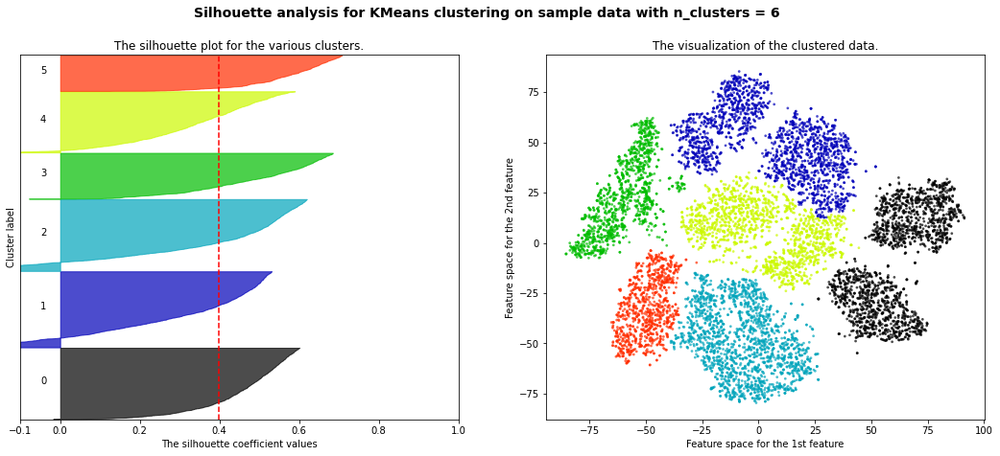

...

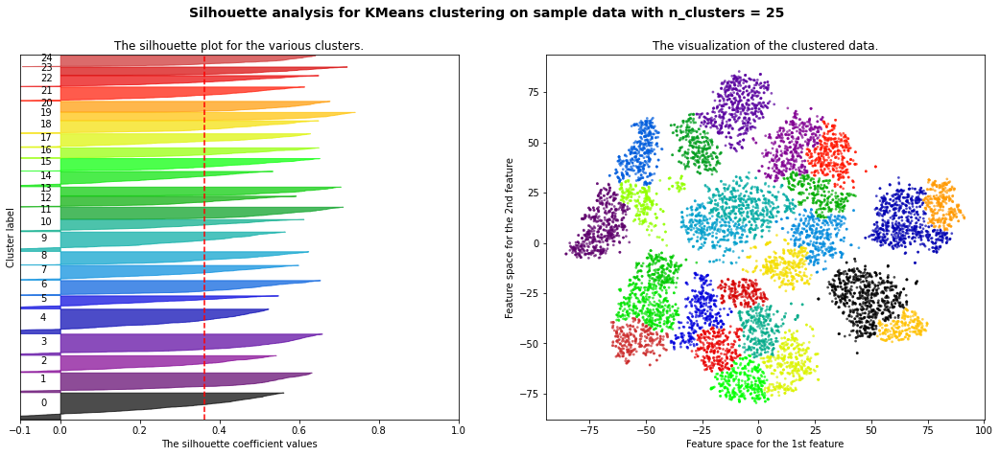

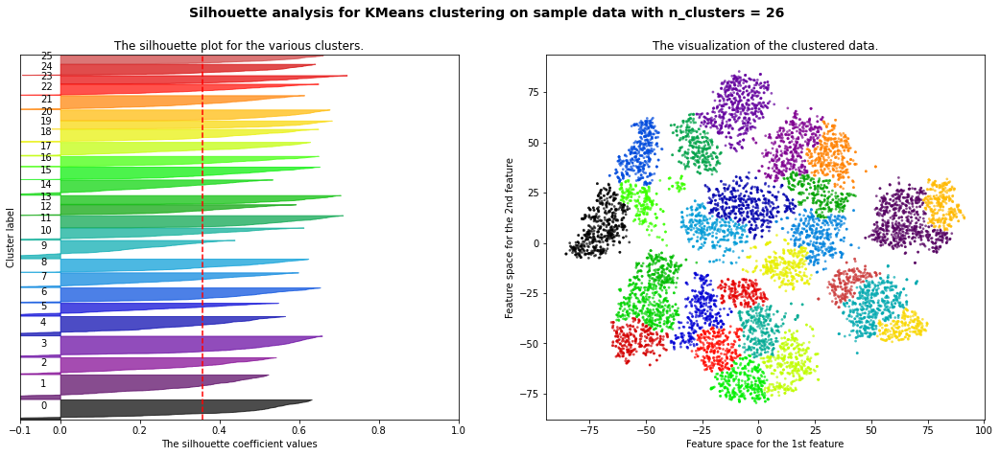

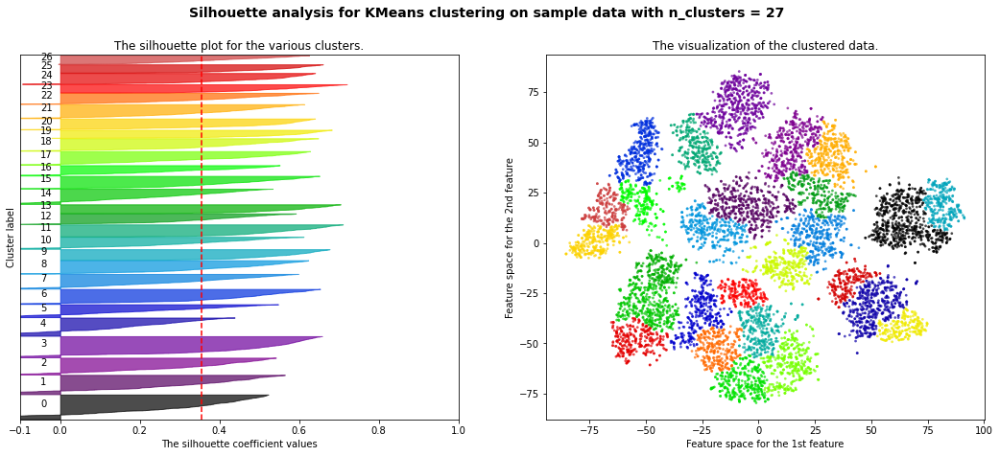

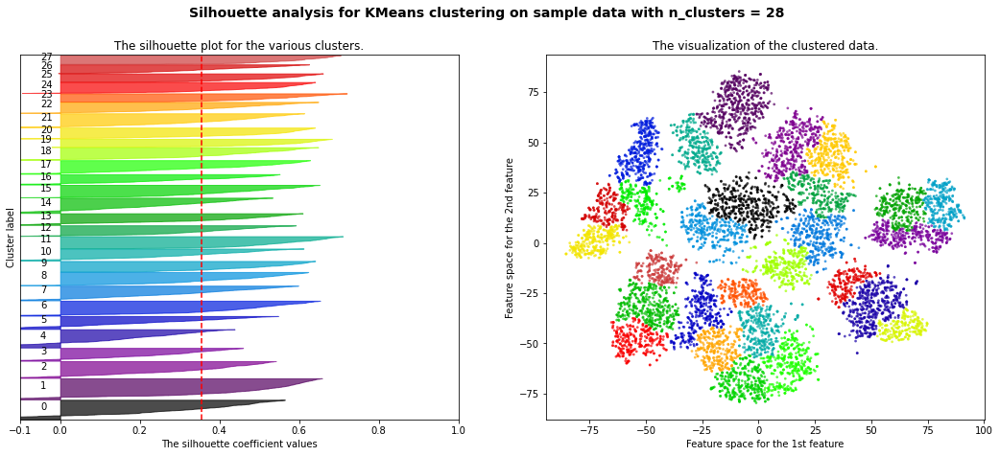

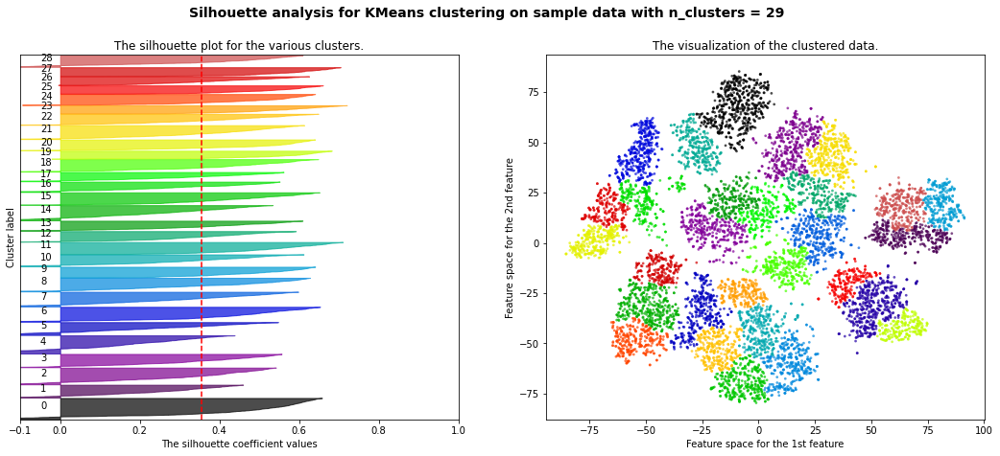

In [81]:
compute_and_print_silhouette_for_birch(threshold=0.25, branching_factor=50)

For n_clusters = 2 The average silhouette_score is : 0.30762562
For n_clusters = 3 The average silhouette_score is : 0.38465098
For n_clusters = 4 The average silhouette_score is : 0.39906546
For n_clusters = 5 The average silhouette_score is : 0.39926377
For n_clusters = 6 The average silhouette_score is : 0.39451894
For n_clusters = 7 The average silhouette_score is : 0.42082793
For n_clusters = 8 The average silhouette_score is : 0.41665995
For n_clusters = 9 The average silhouette_score is : 0.43342412
For n_clusters = 10 The average silhouette_score is : 0.44203565
For n_clusters = 11 The average silhouette_score is : 0.43329278
For n_clusters = 12 The average silhouette_score is : 0.42120665
For n_clusters = 13 The average silhouette_score is : 0.42372373
For n_clusters = 14 The average silhouette_score is : 0.41733038
For n_clusters = 15 The average silhouette_score is : 0.41556442
For n_clusters = 16 The average silhouette_score is : 0.41380742
For n_clusters = 17 The average s

<ipython-input-77-8784fd9bf5c6>:11: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, (ax1, ax2) = plt.subplots(1, 2)


For n_clusters = 22 The average silhouette_score is : 0.35764292
For n_clusters = 23 The average silhouette_score is : 0.36040926
For n_clusters = 24 The average silhouette_score is : 0.35703418
For n_clusters = 25 The average silhouette_score is : 0.35316068
For n_clusters = 26 The average silhouette_score is : 0.34796736
For n_clusters = 27 The average silhouette_score is : 0.34598714
For n_clusters = 28 The average silhouette_score is : 0.3390382
For n_clusters = 29 The average silhouette_score is : 0.34618148


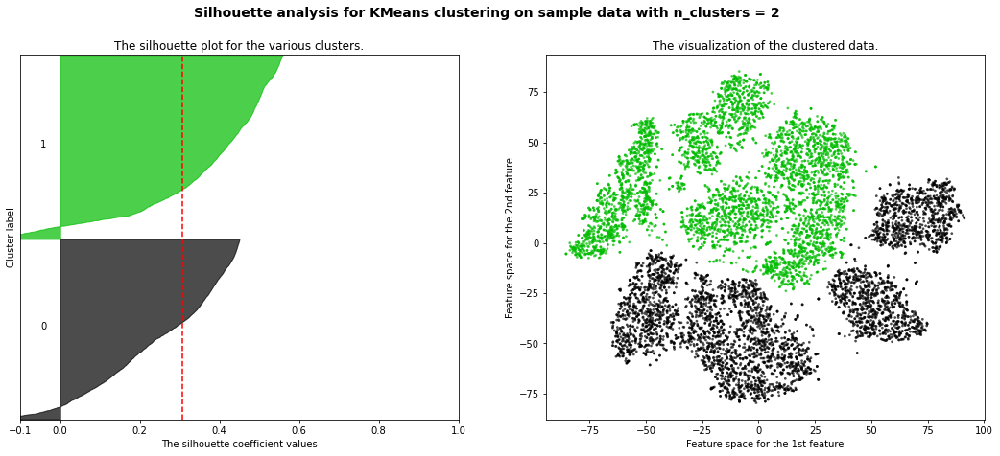

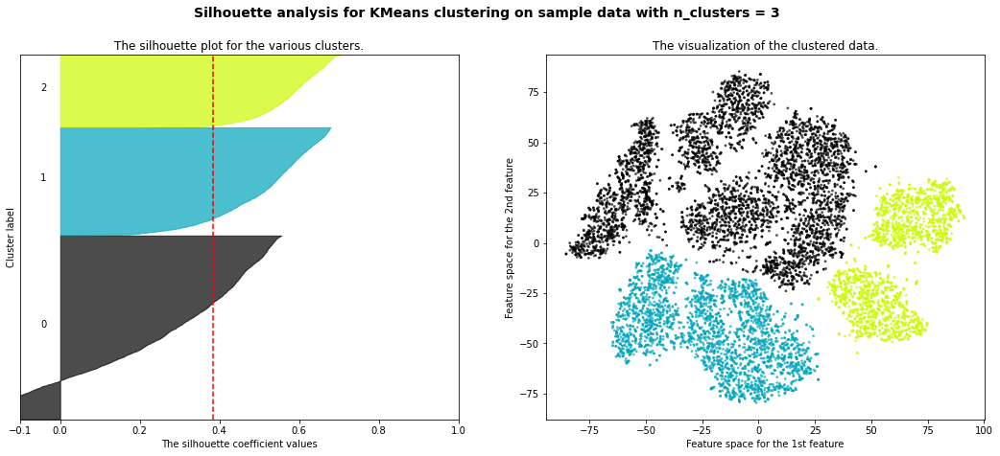

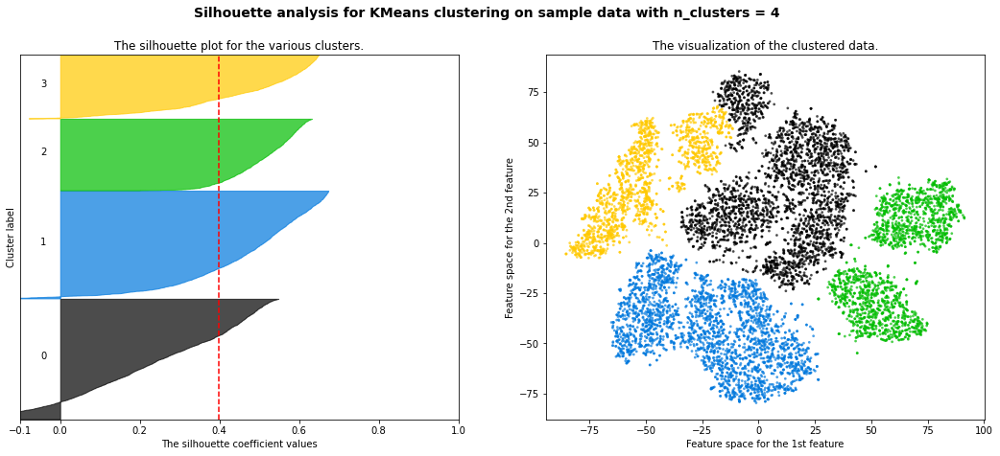

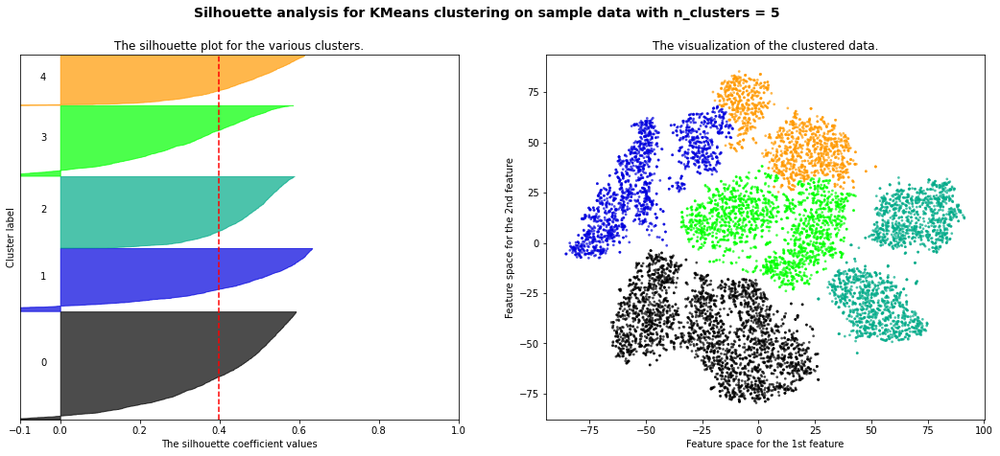

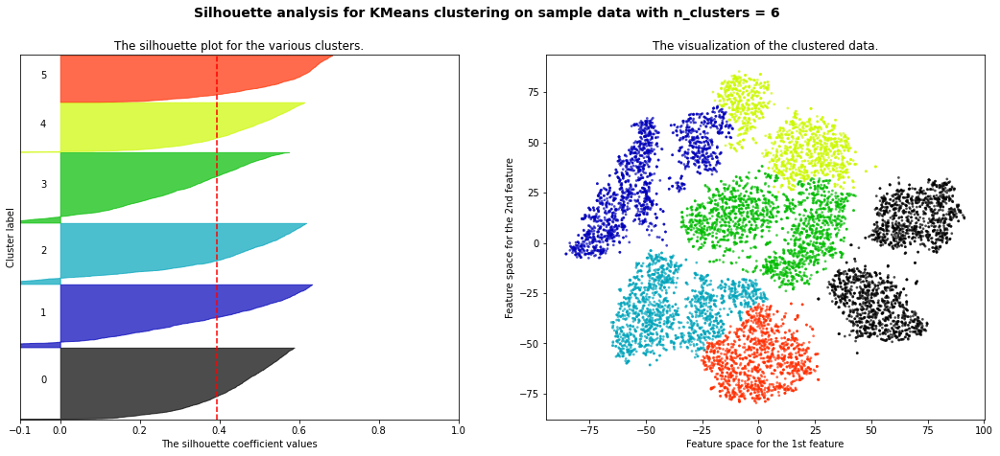

...

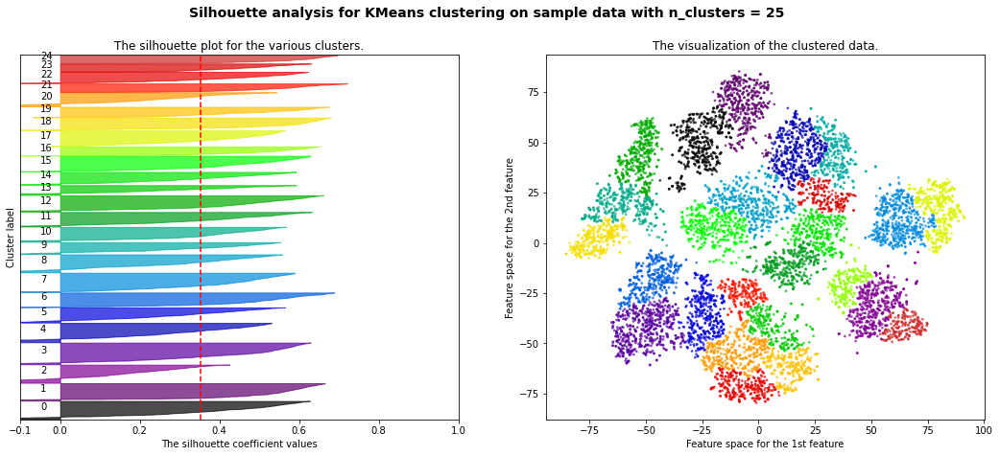

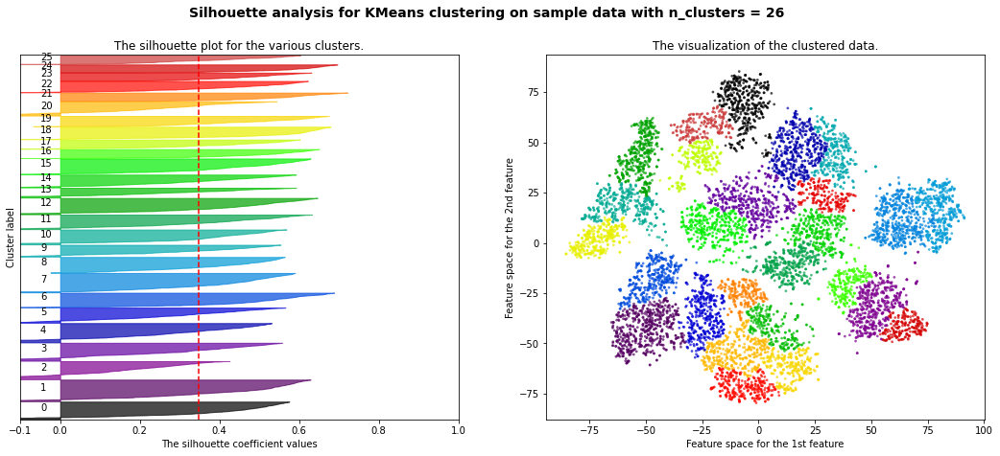

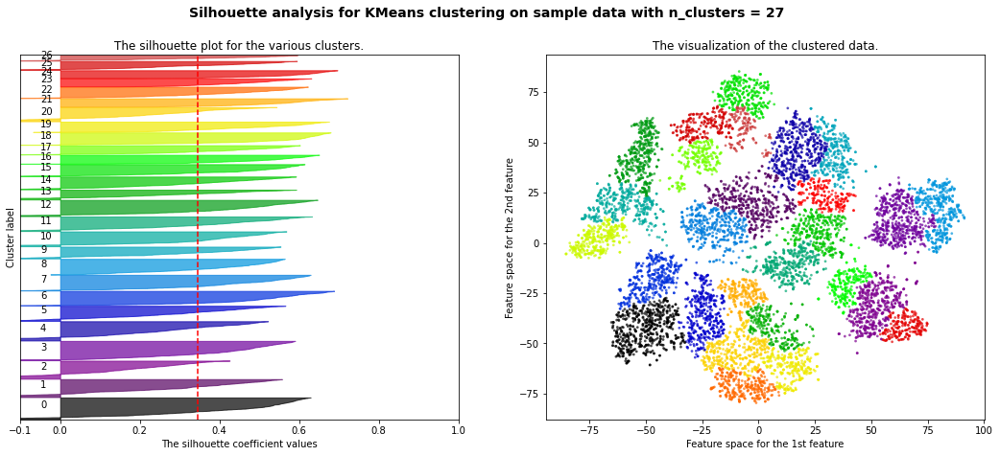

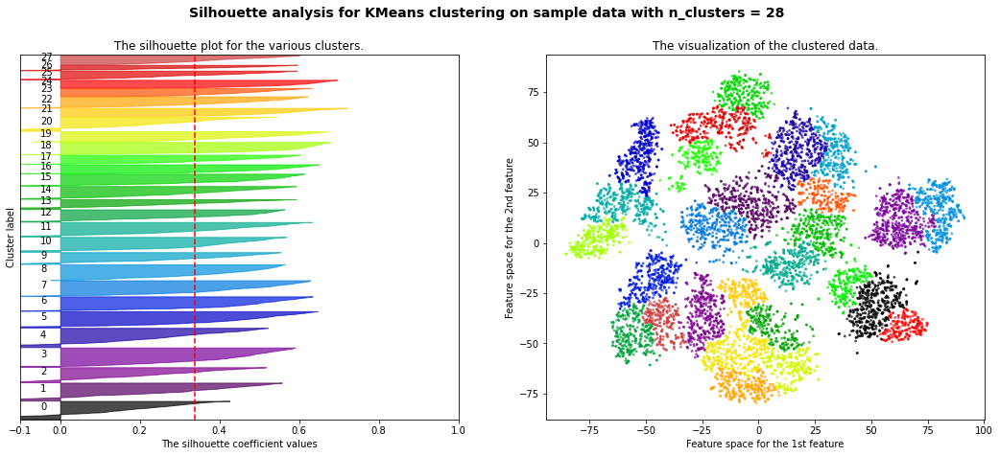

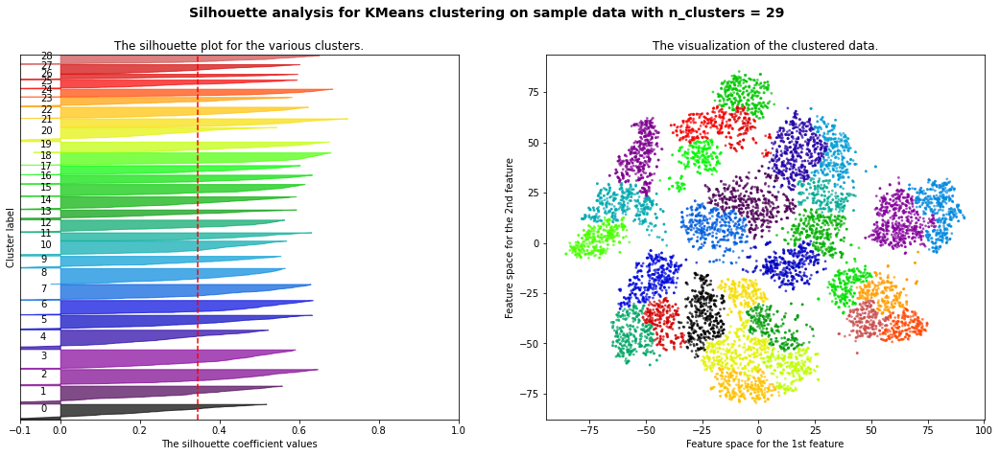

In [82]:
compute_and_print_silhouette_for_birch(threshold=0.75, branching_factor=50)

For n_clusters = 2 The average silhouette_score is : 0.31369558
For n_clusters = 3 The average silhouette_score is : 0.38429502
For n_clusters = 4 The average silhouette_score is : 0.3961921
For n_clusters = 5 The average silhouette_score is : 0.39626616
For n_clusters = 6 The average silhouette_score is : 0.40168187
For n_clusters = 7 The average silhouette_score is : 0.4256779
For n_clusters = 8 The average silhouette_score is : 0.44293594
For n_clusters = 9 The average silhouette_score is : 0.4608296
For n_clusters = 10 The average silhouette_score is : 0.445817
For n_clusters = 11 The average silhouette_score is : 0.44469917
For n_clusters = 12 The average silhouette_score is : 0.43809286
For n_clusters = 13 The average silhouette_score is : 0.42646933
For n_clusters = 14 The average silhouette_score is : 0.4088081
For n_clusters = 15 The average silhouette_score is : 0.4027631
For n_clusters = 16 The average silhouette_score is : 0.409449
For n_clusters = 17 The average silhouette

<ipython-input-77-8784fd9bf5c6>:11: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, (ax1, ax2) = plt.subplots(1, 2)


For n_clusters = 22 The average silhouette_score is : 0.3624233
For n_clusters = 23 The average silhouette_score is : 0.36590162
For n_clusters = 24 The average silhouette_score is : 0.36590907
For n_clusters = 25 The average silhouette_score is : 0.36662227
For n_clusters = 26 The average silhouette_score is : 0.3644623
For n_clusters = 27 The average silhouette_score is : 0.37009203
For n_clusters = 28 The average silhouette_score is : 0.36625195
For n_clusters = 29 The average silhouette_score is : 0.36531627


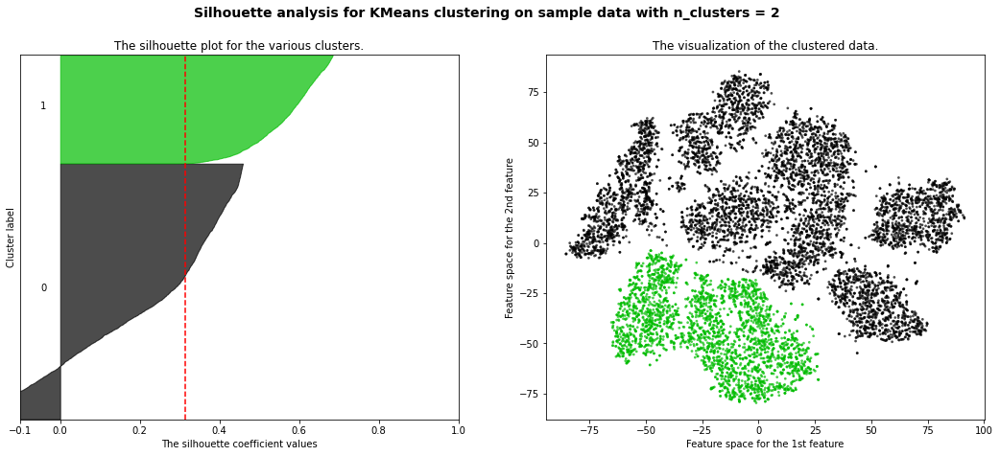

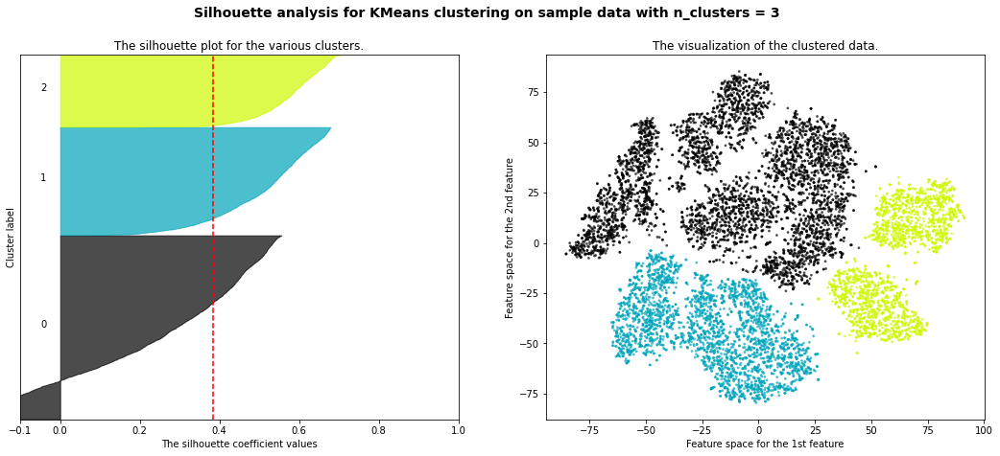

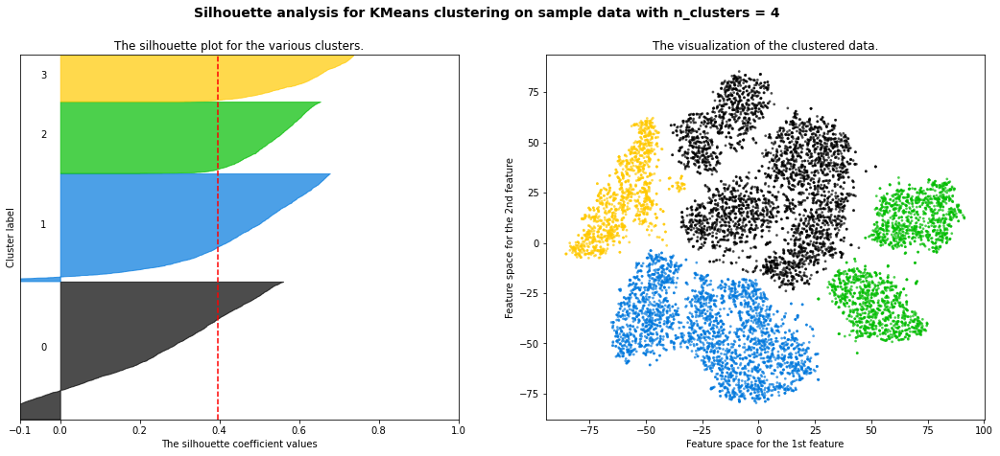

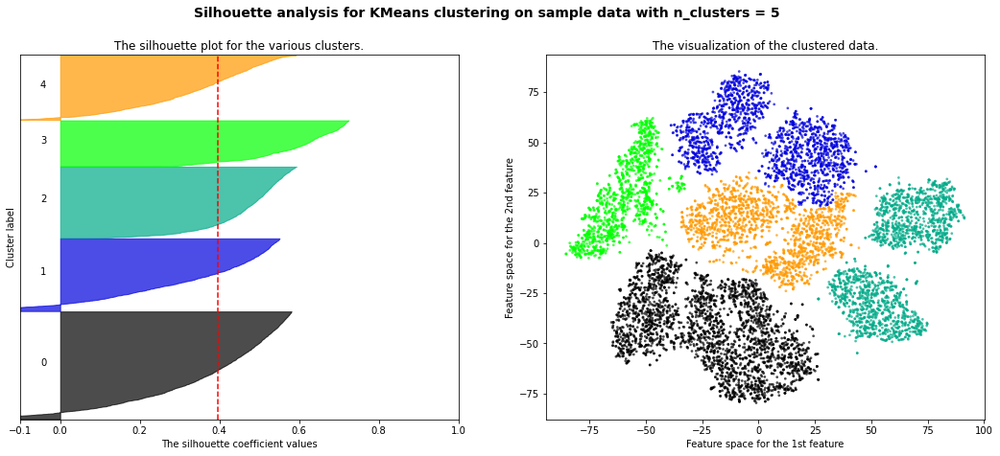

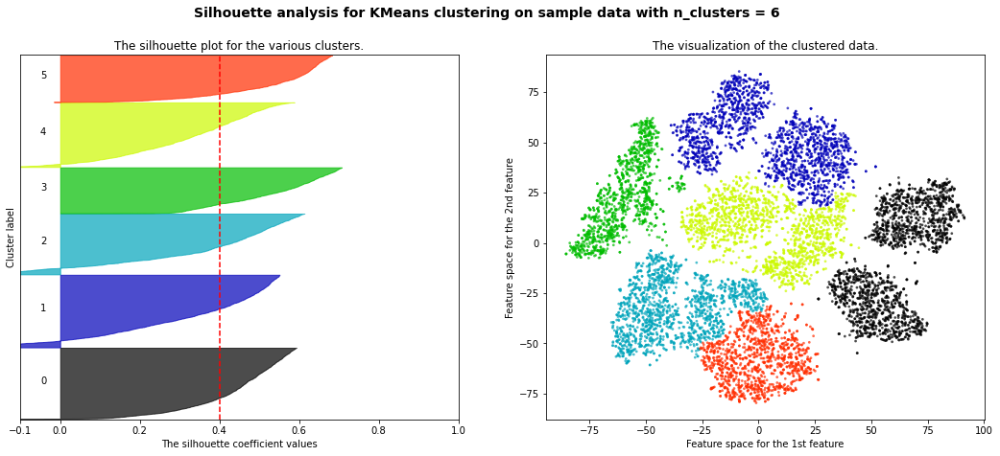

...

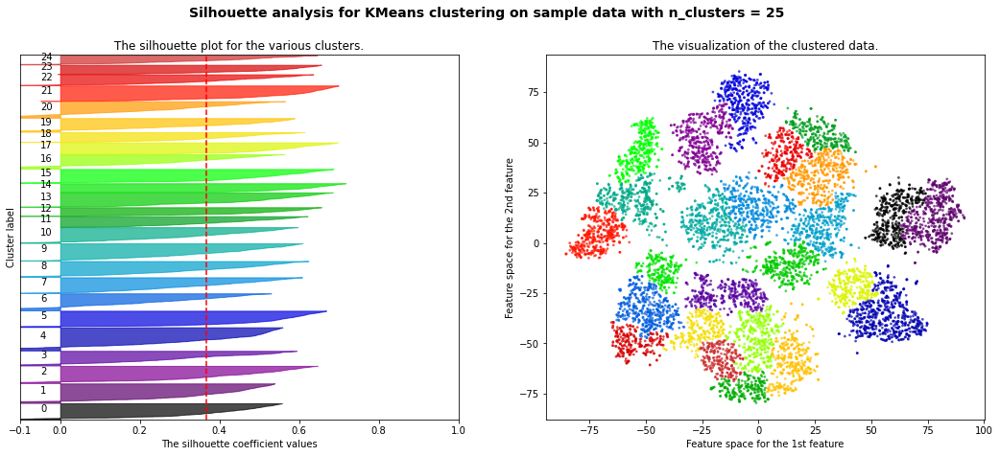

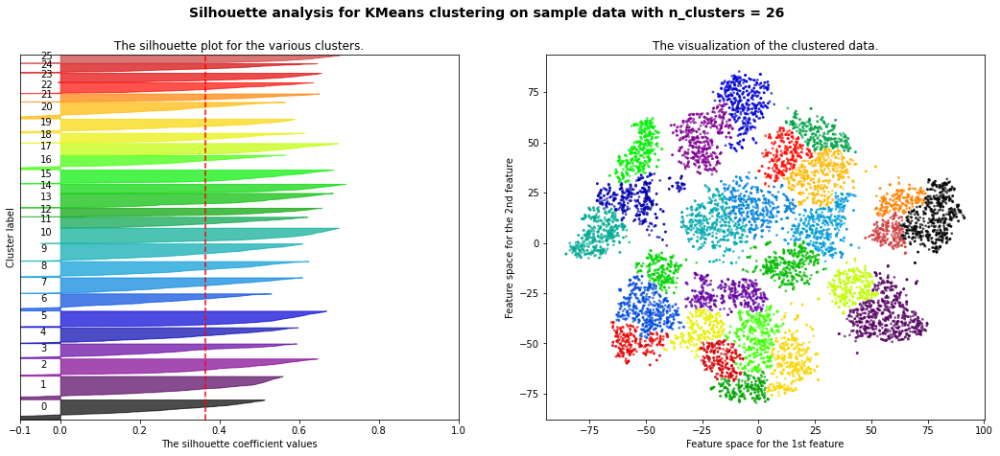

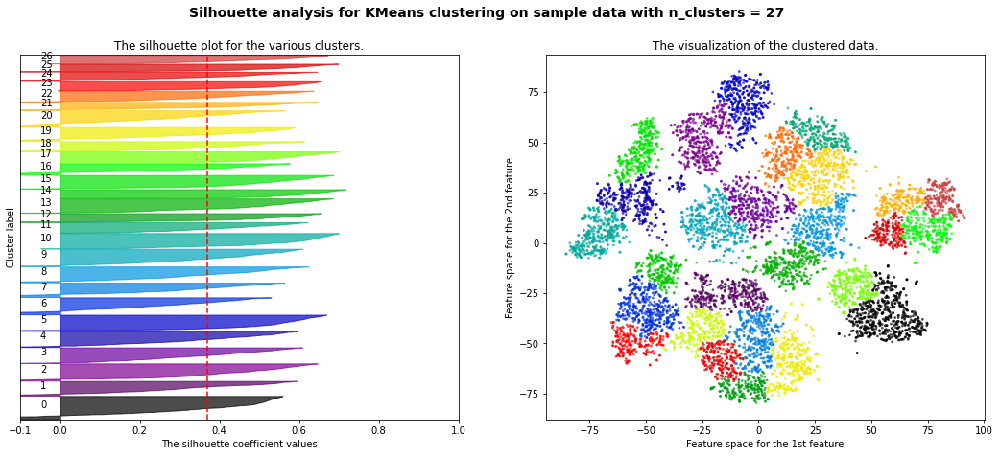

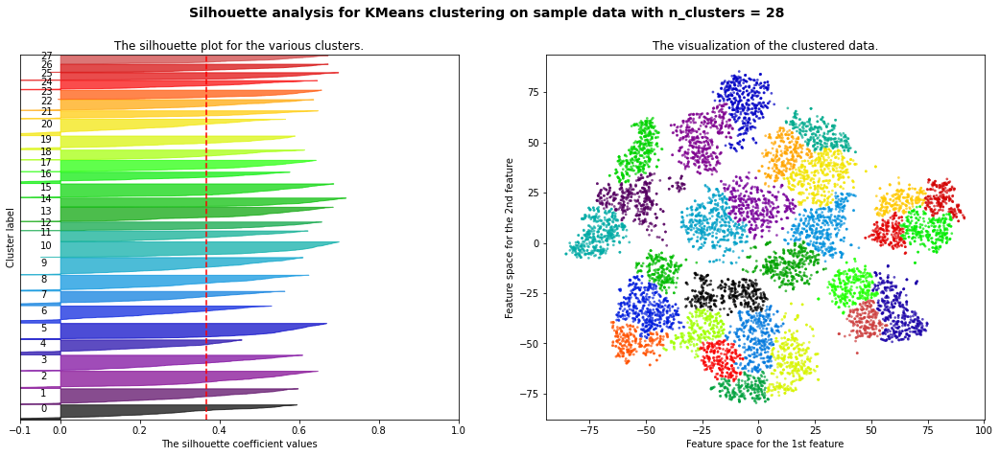

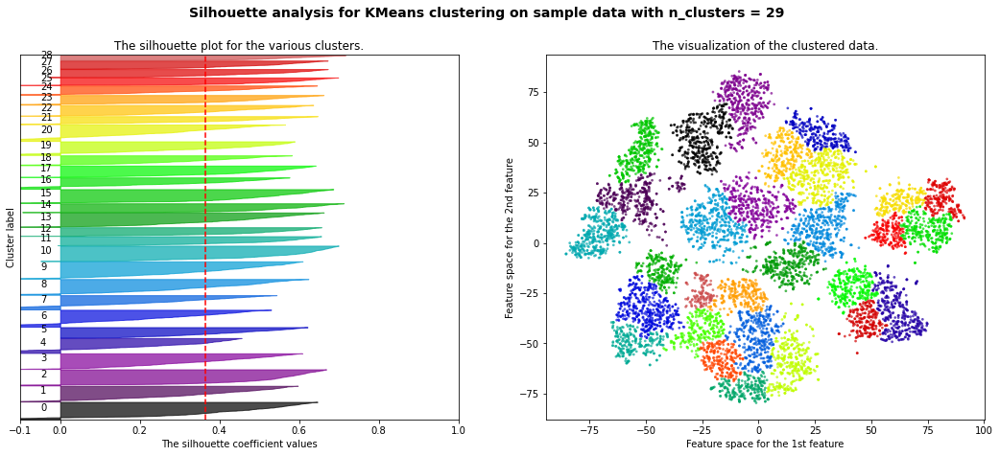

In [83]:
compute_and_print_silhouette_for_birch(threshold=0.5, branching_factor=100)

For n_clusters = 2 The average silhouette_score is : 0.31355625
For n_clusters = 3 The average silhouette_score is : 0.38454735
For n_clusters = 4 The average silhouette_score is : 0.39646623
For n_clusters = 5 The average silhouette_score is : 0.38829845
For n_clusters = 6 The average silhouette_score is : 0.39656797
For n_clusters = 7 The average silhouette_score is : 0.4090958
For n_clusters = 8 The average silhouette_score is : 0.44645172
For n_clusters = 9 The average silhouette_score is : 0.45288783
For n_clusters = 10 The average silhouette_score is : 0.43770444
For n_clusters = 11 The average silhouette_score is : 0.43662027
For n_clusters = 12 The average silhouette_score is : 0.42693868
For n_clusters = 13 The average silhouette_score is : 0.4234004
For n_clusters = 14 The average silhouette_score is : 0.408666
For n_clusters = 15 The average silhouette_score is : 0.40779433
For n_clusters = 16 The average silhouette_score is : 0.4068806
For n_clusters = 17 The average silhou

<ipython-input-77-8784fd9bf5c6>:11: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, (ax1, ax2) = plt.subplots(1, 2)


For n_clusters = 22 The average silhouette_score is : 0.3743107
For n_clusters = 23 The average silhouette_score is : 0.37174717
For n_clusters = 24 The average silhouette_score is : 0.37134105
For n_clusters = 25 The average silhouette_score is : 0.3669651
For n_clusters = 26 The average silhouette_score is : 0.36446136
For n_clusters = 27 The average silhouette_score is : 0.35937238
For n_clusters = 28 The average silhouette_score is : 0.35819414
For n_clusters = 29 The average silhouette_score is : 0.35547337


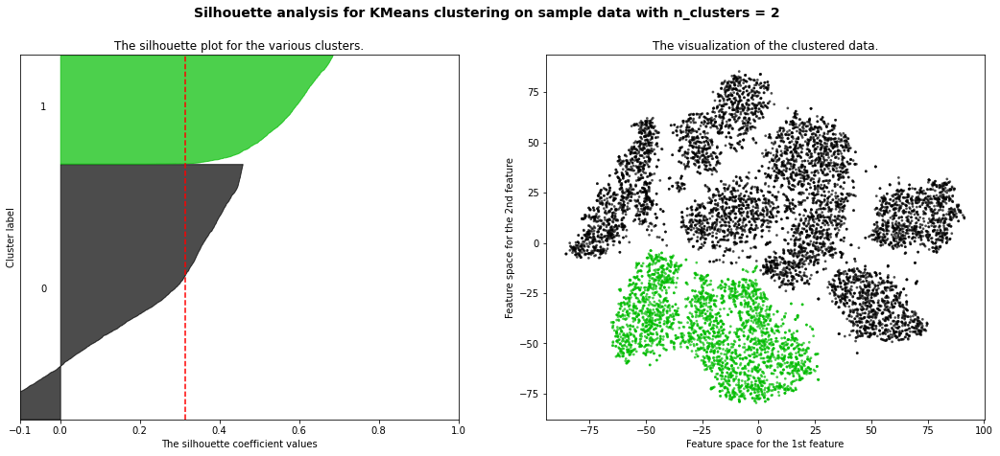

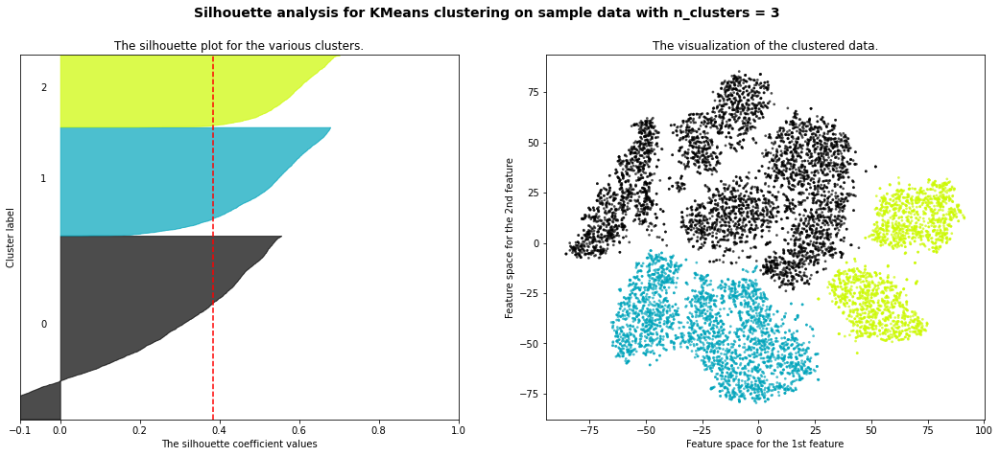

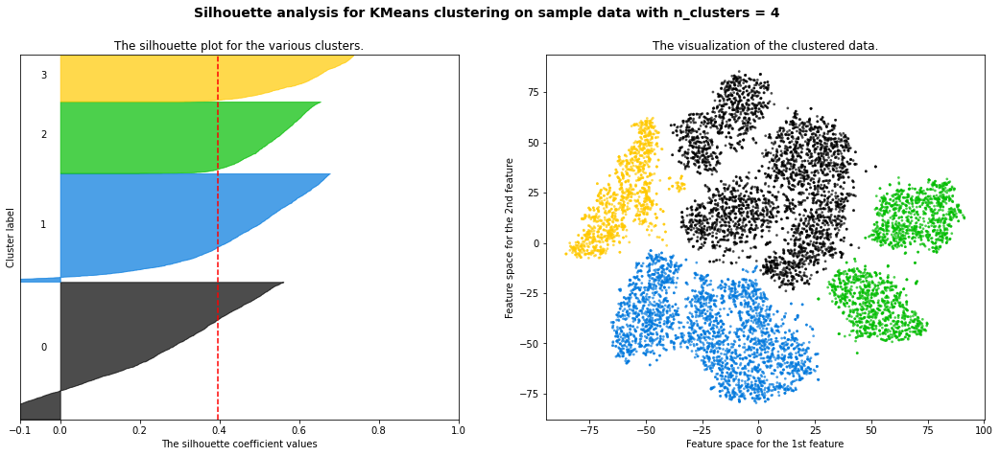

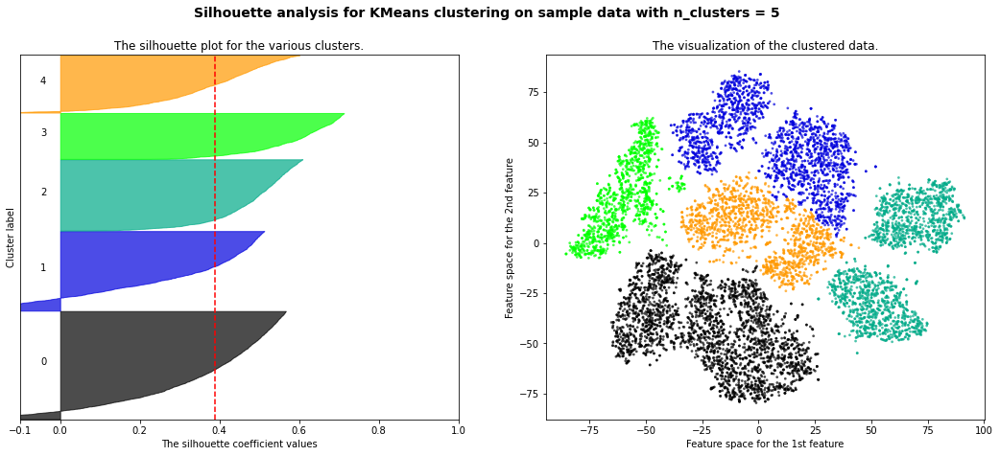

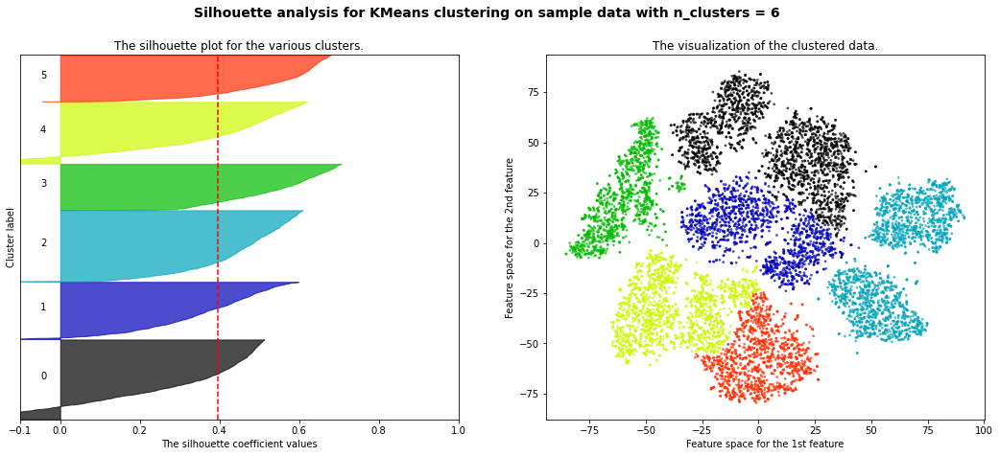

...

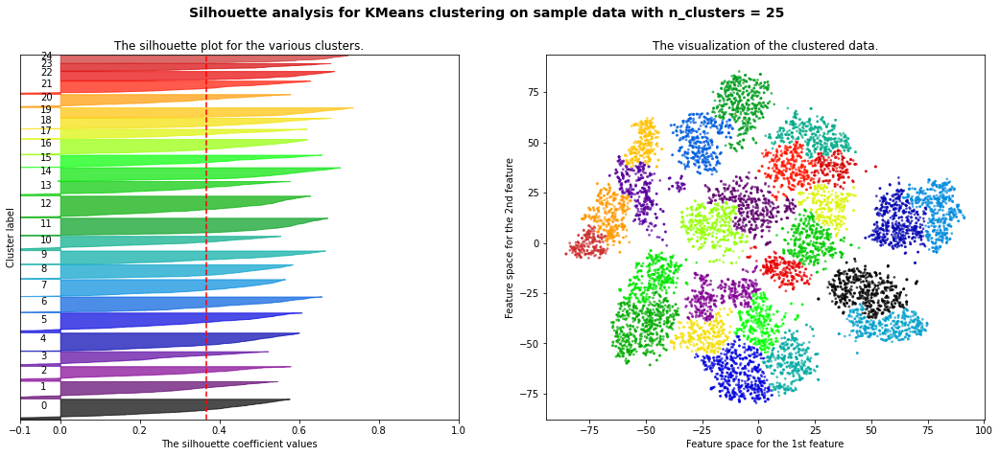

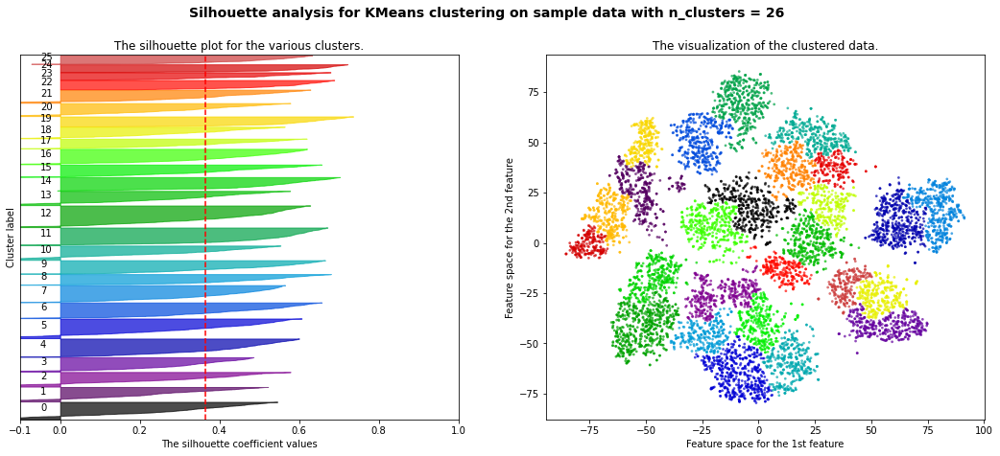

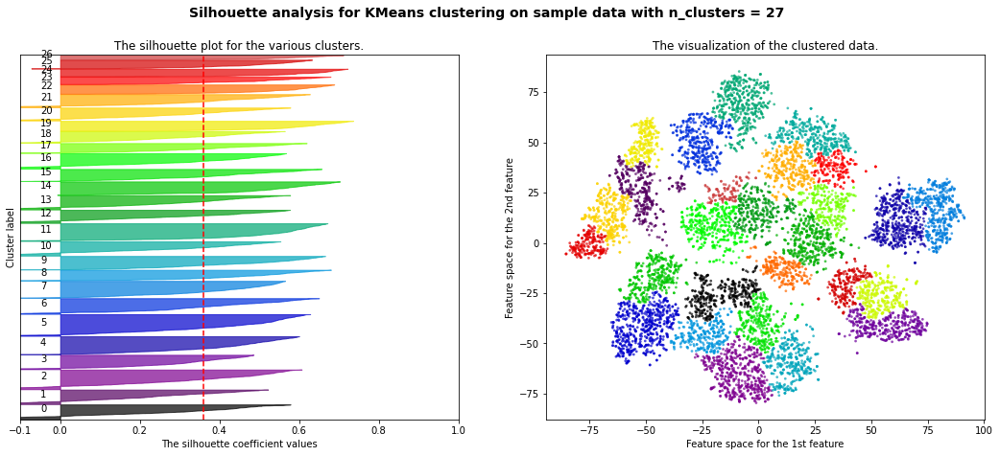

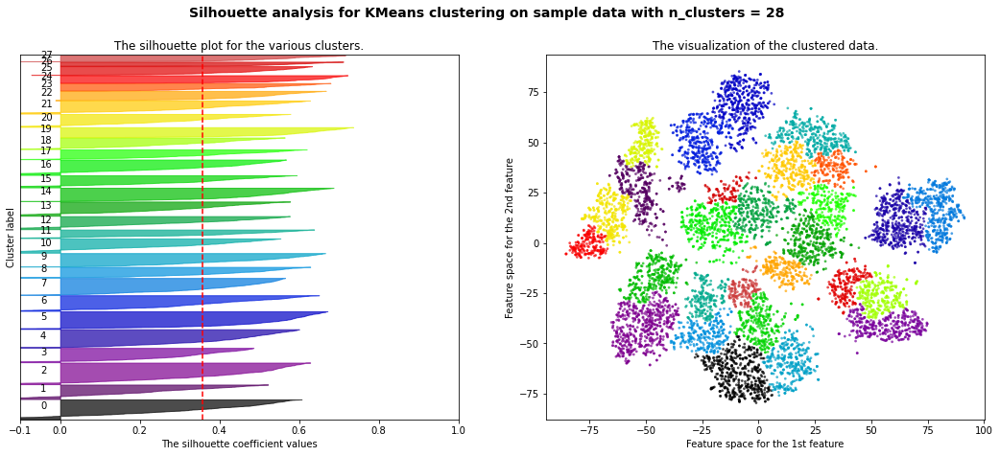

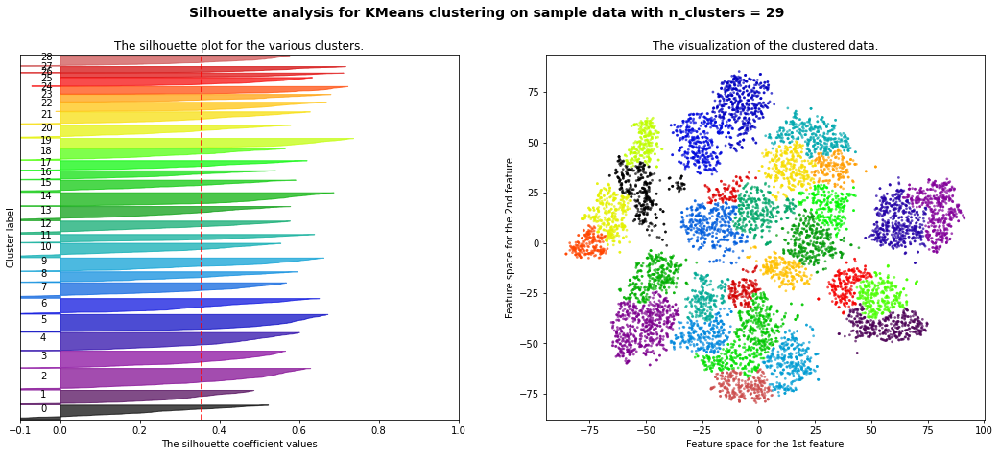

In [84]:
compute_and_print_silhouette_for_birch(threshold=0.75, branching_factor=100)